#Entrenamiento Deteccion de Objectos


### Montar carpeta google drive

In [ ]:
!python --version

Python 3.10.6


In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


Creamos 2 carpetas en una carpeta de modelo_entrenar:
- datos
- entrenamiento

In [ ]:
import os
%cd /content/gdrive/MyDrive/
!mkdir modelo_entrenar
%cd /content/gdrive/MyDrive/modelo_entrenar
!mkdir datos entrenamiento

/content/gdrive/MyDrive
/content/gdrive/MyDrive/modelo_entrenar


In [ ]:
# Clone the tensorflow models repository from GitHub
!git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3929, done.
remote: Counting objects: 100% (3929/3929), done.
remote: Compressing objects: 100% (3032/3032), done.
remote: Total 3929 (delta 1145), reused 1898 (delta 844), pack-reused 0
Receiving objects: 100% (3929/3929), 49.67 MiB | 8.53 MiB/s, done.
Resolving deltas: 100% (1145/1145), done.


In [ ]:
# Copy setup files into models/research folder
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
#cp object_detection/packages/tf2/setup.py .

In [ ]:
# Modify setup.py file to install the tf-models-official repository targeted at TF v2.8.0
import re
with open('/content/models/research/object_detection/packages/tf2/setup.py') as f:
    s = f.read()

with open('/content/models/research/setup.py', 'w') as f:
    # Set fine_tune_checkpoint path
    s = re.sub('tf-models-official>=2.5.1',
               'tf-models-official==2.8.0', s)
    f.write(s)

In [ ]:
# Install the Object Detection API
!pip install /content/models/research/

# Need to downgrade to TF v2.8.0 due to Colab compatibility bug with TF v2.10 (as of 10/03/22)
!pip install tensorflow==2.8.0

Processing ./models/research
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 67.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 38.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.0/28.0 MB 44.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.1/175.1 kB 19.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  error: subprocess-exited-with-error
  
  × Getting requirements to build wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Getting requirements to build wheel ... error
error: subprocess-exited-with-error

× Getting requirements to build wheel 

## 1. Instalacion de librerias estables y API deteccion de objetos

Librerias para deteccion de objetos

Instalacion de API de tensorflow

In [ ]:
%cd  /content/
import os
import pathlib

# Clonamos del repositorio
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models



/content


In [ ]:
# Instalacion de API deteccion de objetos
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached avro-python3-1.10.2.tar.gz (38 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached apache_beam-2.49.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (14.6 MB)
  Using cached lvis-0.5.3-py3-none-any.whl (14 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 32.6 MB/s eta 0:00:00
  Using cached tensorflow_io-0.32.0-cp310-cp310-manylinux_2_12_x86_64.manylinux2010_x86_64.whl (28.0 MB)
  Using cached pyparsing-2.4.7-py2.py3-none-any.whl (67 kB)
  Using cached sacrebleu-2.2.0-py3-none-any.whl (116 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 269.4/269.4 kB 31.7 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 52.6 MB/s eta 0

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flax 0.7.0 requires PyYAML>=5.4.1, but you have pyyaml 5.3.1 which is incompatible.
numba 0.56.4 requires numpy<1.24,>=1.18, but you have numpy 1.24.3 which is incompatible.


## 2. Datos para Entrenamiento

Subimos los archivos .zip de las imagenes y anotaciones

In [ ]:
%cd /content/gdrive/MyDrive/modelo_entrenar/datos

!unzip /content/gdrive/MyDrive/modelo_entrenar/datos/Imagenes.zip -d .
!unzip /content/gdrive/MyDrive/modelo_entrenar/datos/Anotaciones.zip -d .

Se truncaron las últimas líneas 5000 del resultado de transmisión.
  inflating: ./Imagenes/scottish_terrier_169.jpg  
  inflating: ./Imagenes/scottish_terrier_17.jpg  
  inflating: ./Imagenes/scottish_terrier_170.jpg  
  inflating: ./Imagenes/scottish_terrier_171.jpg  
  inflating: ./Imagenes/scottish_terrier_172.jpg  
  inflating: ./Imagenes/scottish_terrier_173.jpg  
  inflating: ./Imagenes/scottish_terrier_174.jpg  
  inflating: ./Imagenes/scottish_terrier_175.jpg  
  inflating: ./Imagenes/scottish_terrier_176.jpg  
  inflating: ./Imagenes/scottish_terrier_177.jpg  
  inflating: ./Imagenes/scottish_terrier_178.jpg  
  inflating: ./Imagenes/scottish_terrier_179.jpg  
  inflating: ./Imagenes/scottish_terrier_18.jpg  
  inflating: ./Imagenes/scottish_terrier_180.jpg  
  inflating: ./Imagenes/scottish_terrier_181.jpg  
  inflating: ./Imagenes/scottish_terrier_182.jpg  
  inflating: ./Imagenes/scottish_terrier_183.jpg  
  inflating: ./Imagenes/scottish_terrier_184.jpg  
  inflating: ./Im

Creamos las carpetas de train y validation

In [ ]:
%cd /content/gdrive/MyDrive/modelo_entrenar/datos
!mkdir etiquetas_train etiquetas_validation

/content/gdrive/MyDrive/modelo_entrenar/datos


Division de datos de train y validation 80% y 20%

In [ ]:
DIR = '/content/gdrive/MyDrive/modelo_entrenar/datos/Anotaciones'
numero_datos = len([name for name in os.listdir(DIR) if os.path.isfile(os.path.join(DIR, name))])
datos_validacion = int(numero_datos*0.20)
print('numero de datos de validacion: '+str(datos_validacion))

numero de datos de validacion: 737


Dividimos de forma aleatoria con el numero de validacion

In [ ]:
# cambiamos el valor anterior aqui:
!ls Anotaciones/* | sort -R | head -737| xargs -I{} mv {} etiquetas_validation/
!ls Anotaciones/* | xargs -I{} mv {} etiquetas_train/

Creamos los archivos CSV y mapa de etiqueta .pbtxt

Dos clases dog y cat

In [ ]:

%cd  /content/gdrive/MyDrive/modelo_entrenar/datos


import glob
import xml.etree.ElementTree as ET
import pandas as pd


def xml_to_csv(path):
  classes_names = []
  xml_list = []

  for xml_file in glob.glob(path + '/*.xml'):
    tree = ET.parse(xml_file)
    root = tree.getroot()
    for member in root.findall('object'):
      classes_names.append(member[0].text)
      value = (root.find('filename').text  ,
               int(root.find('size')[0].text),
               int(root.find('size')[1].text),
               member[0].text,
               int(member[4][0].text),
               int(member[4][1].text),
               int(member[4][2].text),
               int(member[4][3].text))
      xml_list.append(value)
  column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
  xml_df = pd.DataFrame(xml_list, columns=column_name)
  classes_names = list(set(classes_names))
  classes_names.sort()
  return xml_df, classes_names

for label_path in ['etiquetas_train', 'etiquetas_validation']:
  image_path = os.path.join(os.getcwd(), label_path)
  xml_df, classes = xml_to_csv(label_path)
  xml_df.to_csv(f'{label_path}.csv', index=None)
  print(f'Se convirtio los datos {label_path} xml to csv.')

label_map_path = os.path.join("label_map.pbtxt")
pbtxt_content = ""

for i, class_name in enumerate(classes):
    pbtxt_content = (
        pbtxt_content
        + "item {{\n    id: {0}\n    name: '{1}'\n}}\n\n".format(i + 1, class_name)
    )
pbtxt_content = pbtxt_content.strip()
with open(label_map_path, "w") as f:
    f.write(pbtxt_content)
    print('Se creo el mapa de etiquetas label_map.pbtxt ')

/content/gdrive/MyDrive/modelo_entrenar/datos
Se convirtio los datos etiquetas_train xml to csv.
Se convirtio los datos etiquetas_validation xml to csv.
Se creo el mapa de etiquetas label_map.pbtxt 


Para hacer 5 clases

In [ ]:
''' %cd /content/gdrive/MyDrive/modelo_entrenar/datos

import glob
import xml.etree.ElementTree as ET
import pandas as pd
import os

def xml_to_csv(path):
    classes_names = ['cat', 'dog', 'Chair', 'Sofa', 'Table']
    xml_list = []

    for xml_file in glob.glob(path + '/*.xml'):
        tree = ET.parse(xml_file)
        root = tree.getroot()
        filename = root.find('filename').text
        size = root.find('size')
        width = int(size.find('width').text)
        height = int(size.find('height').text)
        for member in root.findall('object'):
            class_name = member.find('name').text
            if class_name in classes_names:
                bndbox = member.find('bndbox')
                xmin = int(bndbox.find('xmin').text)
                ymin = int(bndbox.find('ymin').text)
                xmax = int(bndbox.find('xmax').text)
                ymax = int(bndbox.find('ymax').text)
                value = (
                    filename,
                    width,
                    height,
                    class_name,
                    xmin,
                    ymin,
                    xmax,
                    ymax
                )
                xml_list.append(value)

    column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
    xml_df = pd.DataFrame(xml_list, columns=column_name)
    return xml_df, classes_names

for label_path in ['etiquetas_train', 'etiquetas_validation']:
    image_path = os.path.join(os.getcwd(), label_path)
    xml_df, classes = xml_to_csv(label_path)
    xml_df.to_csv(f'{label_path}.csv', index=None)
    print(f'Se convirtieron los datos {label_path} de XML a CSV.')

label_map_path = os.path.join("label_map.pbtxt")
pbtxt_content = ""

for i, class_name in enumerate(classes):
    pbtxt_content = (
        pbtxt_content
        + "item {{\n    id: {0}\n    name: '{1}'\n}}\n\n".format(i + 1, class_name)
    )

pbtxt_content = pbtxt_content.strip()
with open(label_map_path, "w") as f:
    f.write(pbtxt_content)
    print('Se creó el mapa de etiquetas label_map.pbtxt') '''




/content/gdrive/MyDrive/modelo_entrenar/datos
Se convirtieron los datos etiquetas_train de XML a CSV.
Se convirtieron los datos etiquetas_validation de XML a CSV.
Se creó el mapa de etiquetas label_map.pbtxt


Con el archivo subido para generar los archivos tfrecord

In [ ]:
!python /content/gdrive/MyDrive/modelo_entrenar/datos/generate_tfrecord.py \
        /content/gdrive/MyDrive/modelo_entrenar/datos/etiquetas_train.csv  \
        /content/gdrive/MyDrive/modelo_entrenar/datos/label_map.pbtxt      \
        /content/gdrive/MyDrive/modelo_entrenar/datos/Imagenes             \
        /content/gdrive/MyDrive/modelo_entrenar/datos/train.record

!python /content/gdrive/MyDrive/modelo_entrenar/datos/generate_tfrecord.py     \
        /content/gdrive/MyDrive/modelo_entrenar/datos/etiquetas_validation.csv \
        /content/gdrive/MyDrive/modelo_entrenar/datos/label_map.pbtxt          \
        /content/gdrive/MyDrive/modelo_entrenar/datos/Imagenes                 \
        /content/gdrive/MyDrive/modelo_entrenar/datos/validation.record

2023-07-26 14:49:31.836915: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-26 14:49:33.490318: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
groups: 100% 2949/2949 [00:07<00:00, 384.49it/s]
Successfully created the TFRecords: /content/gdrive/MyDrive/modelo_entrenar/datos/train.record
2023-07-26 14:49:45.456757: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-26 14:49:46.430876: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT W

## 3. Entrenamiento

Modelos de pre-entrenamientos:
https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md

Creamos la carpeta para el modelo pre entrenado

In [ ]:
%cd /content/gdrive/MyDrive/modelo_entrenar/datos
!mkdir pre_modelo

/content/gdrive/MyDrive/modelo_entrenar/datos


Descargamos el modelo

In [ ]:
%cd /content/gdrive/MyDrive/modelo_entrenar/datos/pre_modelo

!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
!tar -xzvf ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz

/content/gdrive/MyDrive/modelo_entrenar/datos/pre_modelo
--2023-07-26 14:50:08--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.200.128, 2404:6800:4003:c00::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.200.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M  88.5MB/s    in 0.2s    

2023-07-26 14:50:09 (88.5 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’ saved [20515344/20515344]

ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoin

### Configuracion del entrenamiento a traves de archivo pipeline.config

In [ ]:
pipeline_file = '/content/gdrive/MyDrive/modelo_entrenar/datos/pipeline_nuevo.config'

model_dir = '/content/gdrive/MyDrive/modelo_entrenar/entrenamiento'

### Entrenamiento del modelo

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --num_train_steps=10000

2023-07-26 14:50:22.238131: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-26 14:50:23.259319: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6Status12empty_stringB5cxx11Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/

Vizualizar el entrenmiento del modelo

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/gdrive/MyDrive/modelo_entrenar/entrenamiento

<IPython.core.display.Javascript object>

Exportacion del modelo

In [ ]:
#carpeta para guardar el modelo
%cd /content/gdrive/MyDrive/modelo_entrenar/datos
!mkdir fine_tuned_model


/content/gdrive/MyDrive/modelo_entrenar/datos


In [ ]:
import re
import numpy as np

output_directory = '/content/gdrive/MyDrive/modelo_entrenar/datos/fine_tuned_model'
pipeline_file = '/content/gdrive/MyDrive/modelo_entrenar/datos/pipeline_nuevo.config'
last_model_path = '/content/gdrive/MyDrive/modelo_entrenar/entrenamiento'

!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

2023-07-26 15:26:40.199348: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-26 15:26:41.747955: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6Status12empty_stringB5cxx11Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/

### Ver la inferencia del modelo con una imagen

Cargar el modelo

In [ ]:
%cd /content/models/research/object_detection


import tensorflow as tf
import time
import numpy as np
import warnings
warnings.filterwarnings('ignore')
from PIL import Image
from google.colab.patches import cv2_imshow
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

IMAGE_SIZE = (12, 8) # tamano
import matplotlib.pyplot as plt
PATH_TO_SAVED_MODEL="/content/gdrive/MyDrive/modelo_entrenar/datos/fine_tuned_model/saved_model/"
print('Cargando el modelo...', end='')


detect_fn=tf.saved_model.load(PATH_TO_SAVED_MODEL)
print(' Listo!')

/content/models/research/object_detection
Cargando el modelo... Listo!


Inferencia del modelo

Inferencia del modelo

## 4. Tensorflow LITE

Exportar el modelo

In [ ]:
!python /content/models/research/object_detection/export_tflite_graph_tf2.py \
--pipeline_config_path /content/gdrive/MyDrive/modelo_entrenar/datos/pipeline_nuevo.config \
--trained_checkpoint_dir /content/gdrive/MyDrive/modelo_entrenar/entrenamiento \
--output_directory /content/gdrive/MyDrive/modelo_entrenar/datos/tflite

2023-07-26 15:28:13.714454: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6Status12empty_stringB5cxx11Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/pytho

Guardar en punto flotante 32

In [ ]:
%cd /content/gdrive/MyDrive/modelo_entrenar/datos

import tensorflow as tf

saved_model_dir = '/content/gdrive/MyDrive/modelo_entrenar/datos/tflite/saved_model'

converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir)
tflite_model = converter.convert()
open("/content/gdrive/MyDrive/modelo_entrenar/datos/tflite/model_fp32.tflite", "wb").write(tflite_model)

/content/gdrive/MyDrive/modelo_entrenar/datos


11495776

Reduccion del modelo
- Size reduction: up to 50 %
- Latency reduction: 2x
- Accuracy: Insignificant loss accuracy

In [ ]:
import tensorflow as tf
import numpy as np


saved_model_dir = '/content/gdrive/MyDrive/modelo_entrenar/datos/tflite/saved_model/'
dataset_dir = '/content/gdrive/MyDrive/modelo_entrenar/datos/tflite'

converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.target_spec.supported_types = [tf.float16]
tflite_quant_model = converter.convert()

# save model
open("/content/gdrive/MyDrive/modelo_entrenar/datos/tflite/model_fp16.tflite", "wb").write(tflite_quant_model)

5826736

### Agregar los metadatos para la aplicacion android

In [ ]:
!pip install tflite_support_nightly

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 MB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.7/227.7 kB 21.4 MB/s eta 0:00:00


In [ ]:
%cd /content/gdrive/MyDrive/modelo_entrenar/datos/
!mkdir metadata

/content/gdrive/MyDrive/modelo_entrenar/datos


In [ ]:
from tflite_support.metadata_writers import object_detector
from tflite_support.metadata_writers import writer_utils

ObjectDetectorWriter = object_detector.MetadataWriter
_MODEL_PATH = "/content/gdrive/MyDrive/modelo_entrenar/datos/tflite/model_fp16.tflite"
# Task Library expects label files that are in the same format as the one below.
_LABEL_FILE = "/content/gdrive/MyDrive/modelo_entrenar/datos/labelmap.txt"
_SAVE_TO_PATH = "/content/gdrive/MyDrive/modelo_entrenar/datos/metadata/model_fp16_meta.tflite"
# Normalization parameters is required when reprocessing the image. It is
# optional if the image pixel values are in range of [0, 255] and the input
# tensor is quantized to uint8. See the introduction for normalization and
# quantization parameters below for more details.
# https://www.tensorflow.org/lite/models/convert/metadata#normalization_and_quantization_parameters)
_INPUT_NORM_MEAN = 127.5
_INPUT_NORM_STD = 127.5

# Create the metadata writer.
writer = ObjectDetectorWriter.create_for_inference(
    writer_utils.load_file(_MODEL_PATH), [_INPUT_NORM_MEAN], [_INPUT_NORM_STD], [_LABEL_FILE])

# Verify the metadata generated by metadata writer.
print(writer.get_metadata_json())

# Populate the metadata into the model.
writer_utils.save_file(writer.populate(), _SAVE_TO_PATH)

{
  "name": "ObjectDetector",
  "description": "Identify which of a known set of objects might be present and provide information about their positions within the given image or a video stream.",
  "subgraph_metadata": [
    {
      "input_tensor_metadata": [
        {
          "name": "image",
          "description": "Input image to be detected.",
          "content": {
            "content_properties_type": "ImageProperties",
            "content_properties": {
              "color_space": "RGB"
            }
          },
          "process_units": [
            {
              "options_type": "NormalizationOptions",
              "options": {
                "mean": [
                  127.5
                ],
                "std": [
                  127.5
                ]
              }
            }
          ],
          "stats": {
            "max": [
              1.0
            ],
            "min": [
              -1.0
            ]
          }
        }
      ],
     

prueba

Inferencia del modelo

In [ ]:
# Script to run custom TFLite model on test images to detect objects
# Source: https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/TFLite_detection_image.py

# Import packages
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter

import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

### Define function for inferencing with TFLite model and displaying results

def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/content/results', txt_only=False):

  # Grab filenames of all images in test folder
  images = glob.glob(imgpath + '/*.jpg') + glob.glob(imgpath + '/*.JPG') + glob.glob(imgpath + '/*.png') + glob.glob(imgpath + '/*.bmp')

  # Load the label map into memory
  with open(lblpath, 'r') as f:
      labels = [line.strip() for line in f.readlines()]

  # Load the Tensorflow Lite model into memory
  interpreter = Interpreter(model_path=modelpath)
  interpreter.allocate_tensors()

  # Get model details
  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()
  height = input_details[0]['shape'][1]
  width = input_details[0]['shape'][2]

  float_input = (input_details[0]['dtype'] == np.float32)

  input_mean = 127.5
  input_std = 127.5

  # Randomly select test images
  images_to_test = random.sample(images, num_test_images)

  # Loop over every image and perform detection
  for image_path in images_to_test:

      # Load image and resize to expected shape [1xHxWx3]
      image = cv2.imread(image_path)
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      imH, imW, _ = image.shape
      image_resized = cv2.resize(image_rgb, (width, height))
      input_data = np.expand_dims(image_resized, axis=0)

      # Normalize pixel values if using a floating model (i.e. if model is non-quantized)
      if float_input:
          input_data = (np.float32(input_data) - input_mean) / input_std

      # Perform the actual detection by running the model with the image as input
      interpreter.set_tensor(input_details[0]['index'],input_data)
      interpreter.invoke()

      # Retrieve detection results
      boxes = interpreter.get_tensor(output_details[1]['index'])[0] # Bounding box coordinates of detected objects
      classes = interpreter.get_tensor(output_details[3]['index'])[0] # Class index of detected objects
      scores = interpreter.get_tensor(output_details[0]['index'])[0] # Confidence of detected objects

      detections = []

      # Loop over all detections and draw detection box if confidence is above minimum threshold
      for i in range(len(scores)):
          if ((scores[i] > min_conf) and (scores[i] <= 1.0)):

              # Get bounding box coordinates and draw box
              # Interpreter can return coordinates that are outside of image dimensions, need to force them to be within image using max() and min()
              ymin = int(max(1,(boxes[i][0] * imH)))
              xmin = int(max(1,(boxes[i][1] * imW)))
              ymax = int(min(imH,(boxes[i][2] * imH)))
              xmax = int(min(imW,(boxes[i][3] * imW)))

              cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (10, 255, 0), 2)

              # Draw label
              object_name = labels[int(classes[i])] # Look up object name from "labels" array using class index
              label = '%s: %d%%' % (object_name, int(scores[i]*100)) # Example: 'person: 72%'
              labelSize, baseLine = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2) # Get font size
              label_ymin = max(ymin, labelSize[1] + 10) # Make sure not to draw label too close to top of window
              cv2.rectangle(image, (xmin, label_ymin-labelSize[1]-10), (xmin+labelSize[0], label_ymin+baseLine-10), (255, 255, 255), cv2.FILLED) # Draw white box to put label text in
              cv2.putText(image, label, (xmin, label_ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2) # Draw label text

              detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])


      # All the results have been drawn on the image, now display the image
      if txt_only == False: # "text_only" controls whether we want to display the image results or just save them in .txt files
        image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(12,16))
        plt.imshow(image)
        plt.show()

      # Save detection results in .txt files (for calculating mAP)
      elif txt_only == True:

        # Get filenames and paths
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn +'.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)

        # Write results to text file
        # (Using format defined by https://github.com/Cartucho/mAP, which will make it easy to calculate mAP)
        with open(txt_savepath,'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

  return

The next block sets the paths to the test images and models and then runs the inferencing function. If you want to use more than 10 images, change the `images_to_test` variable. Click play to run inferencing!

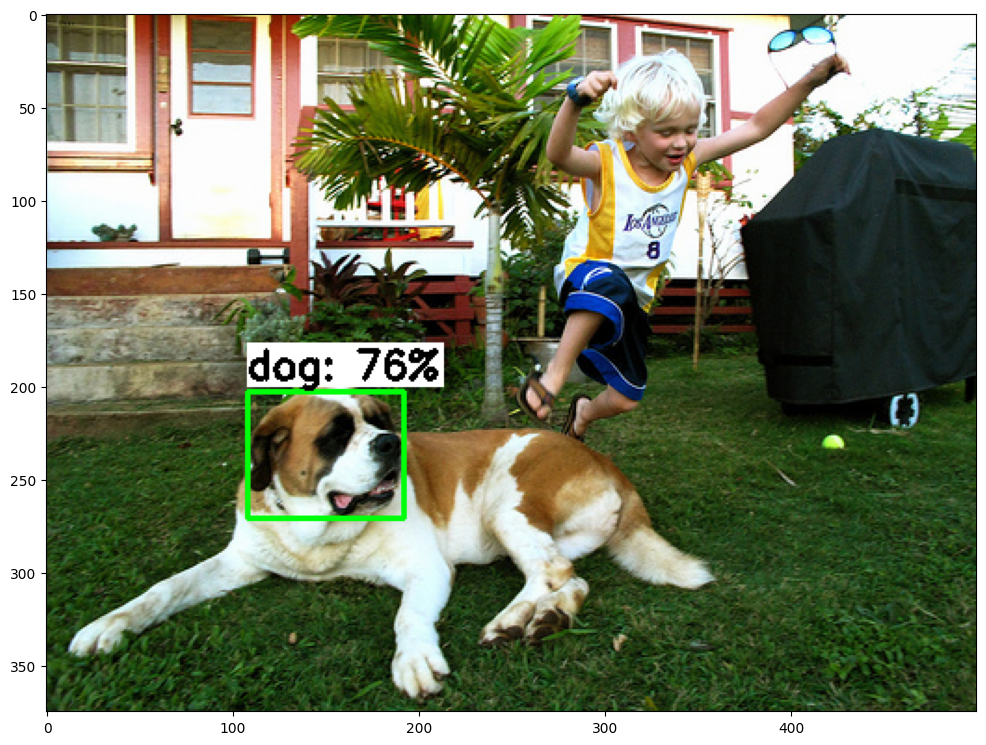

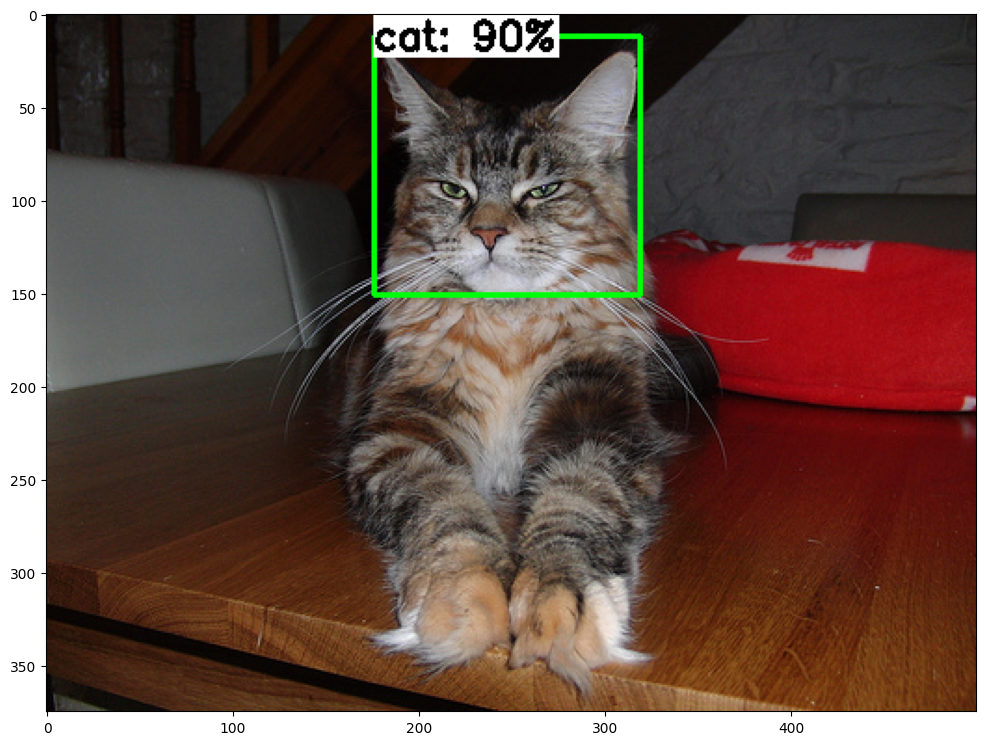

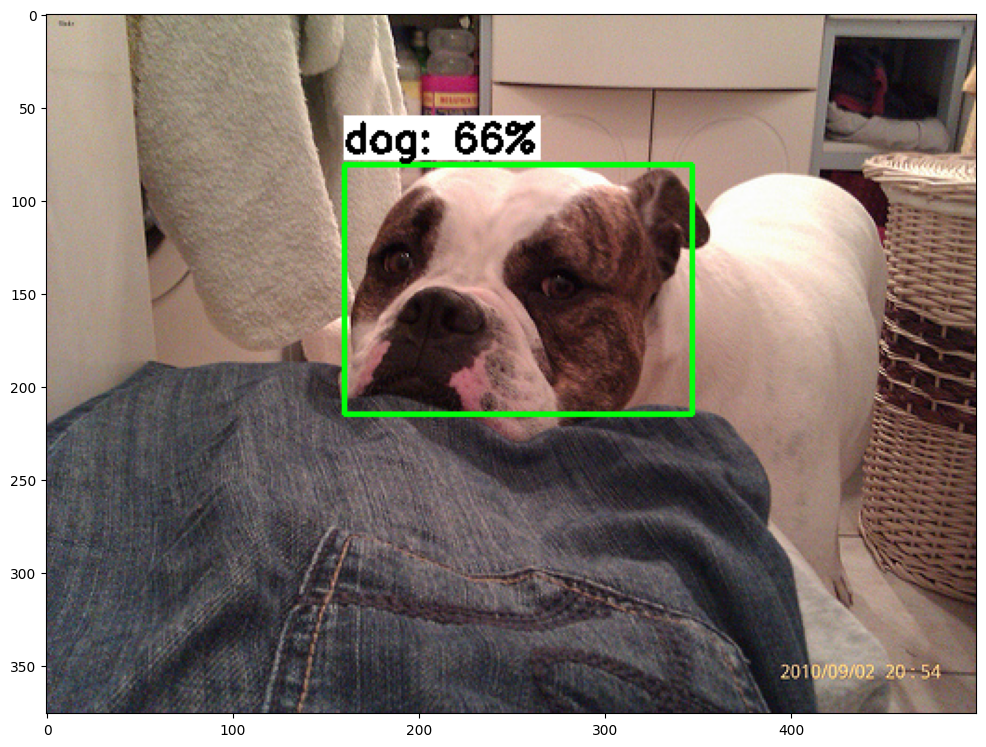

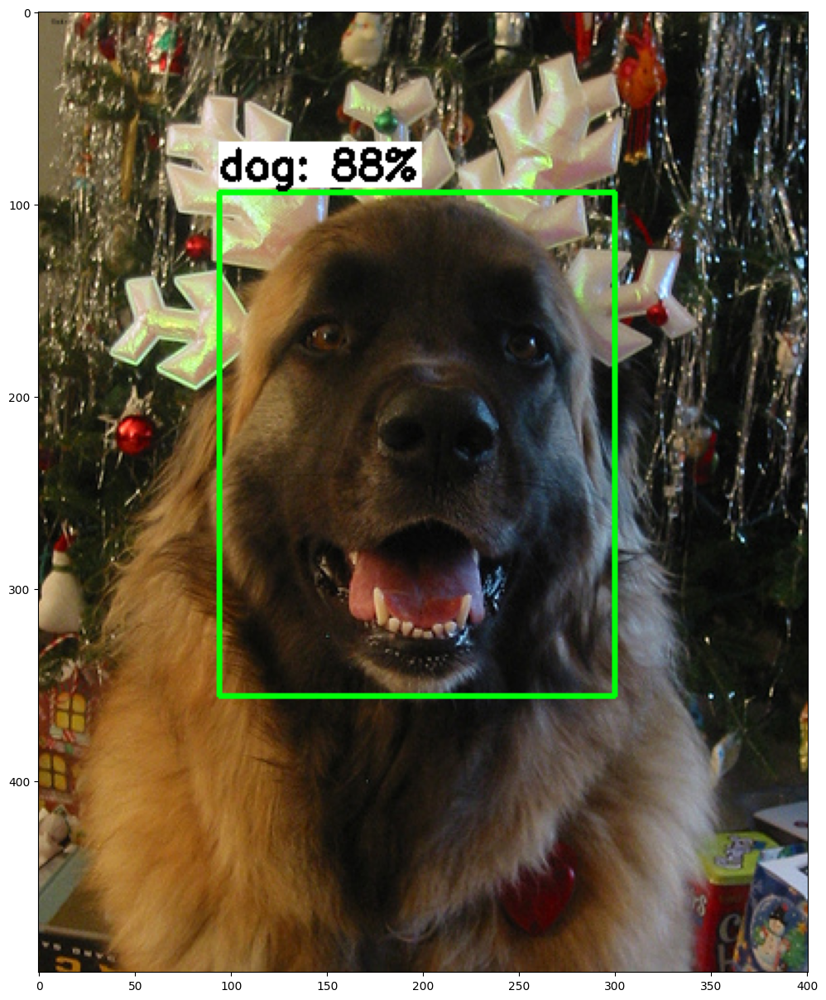

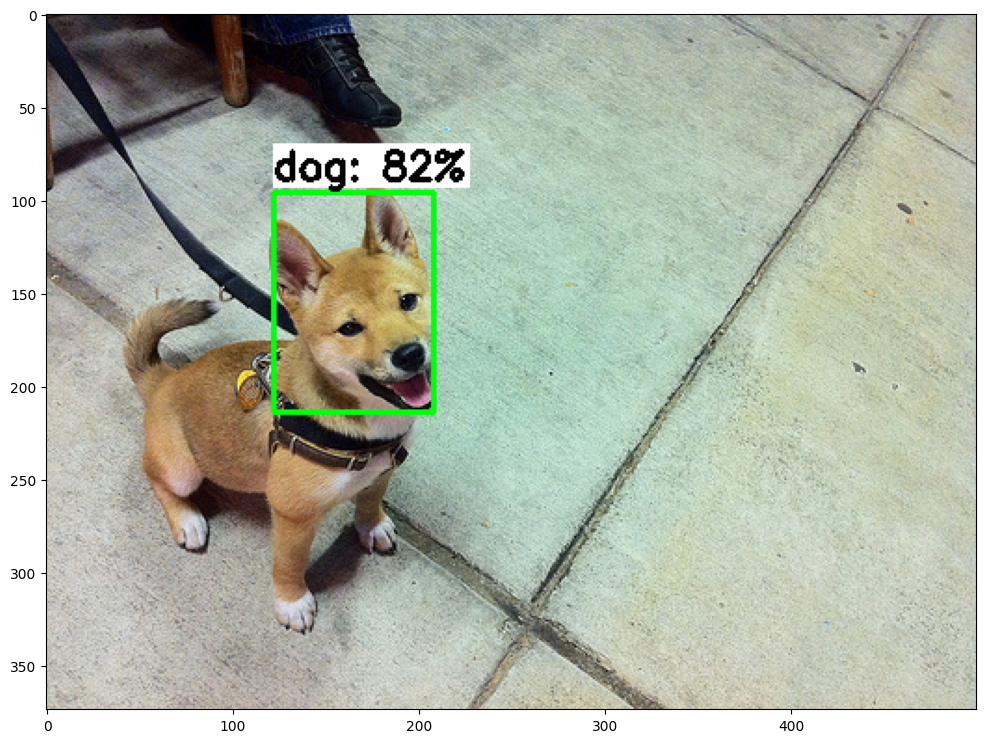

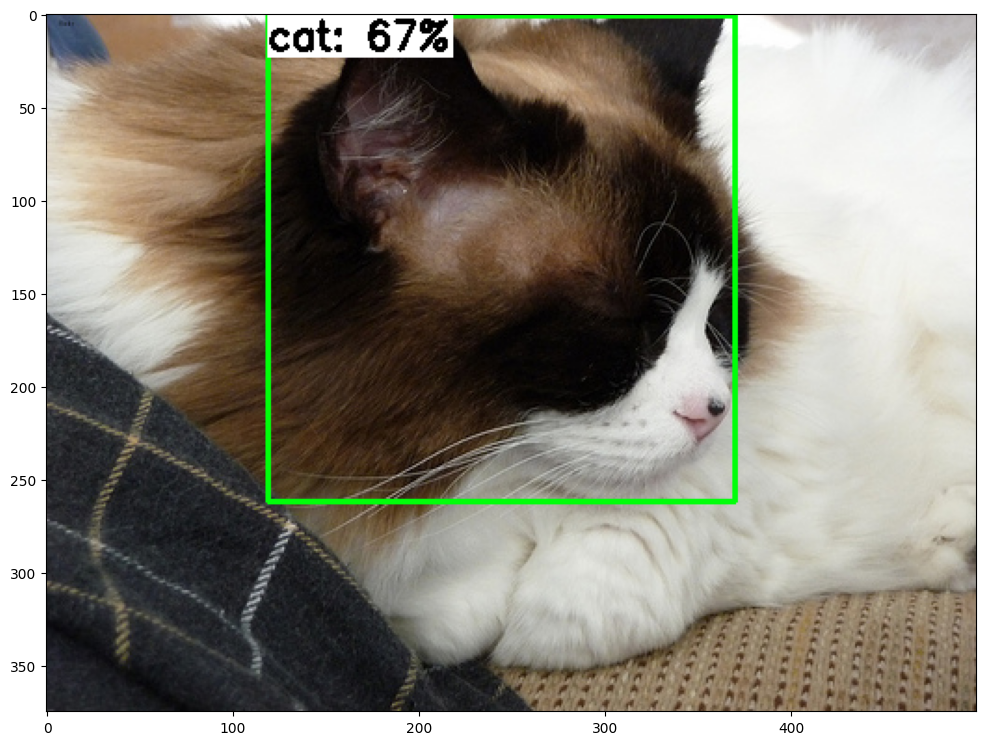

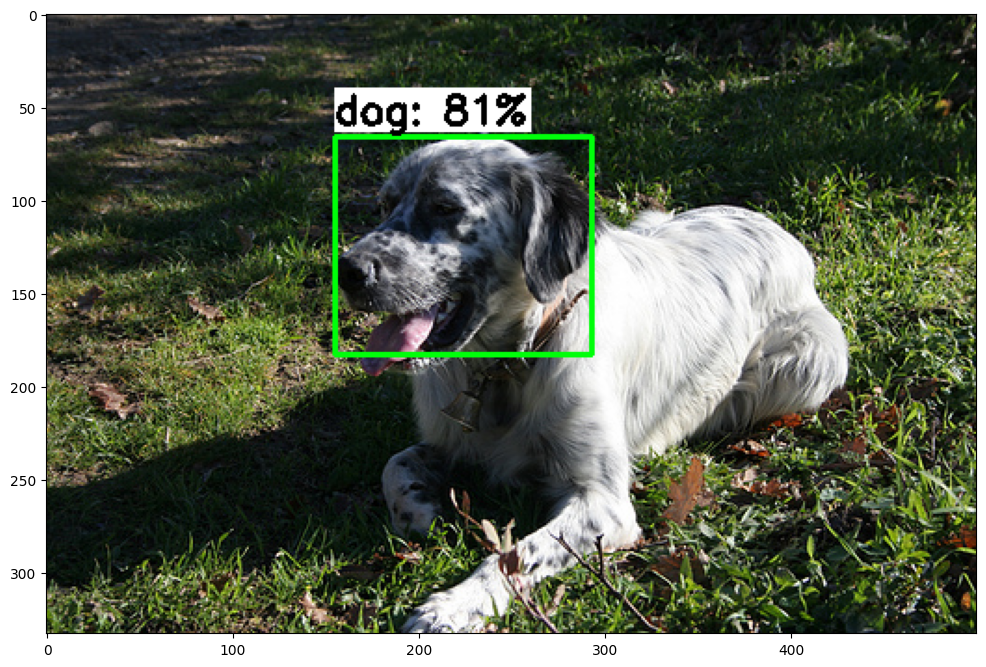

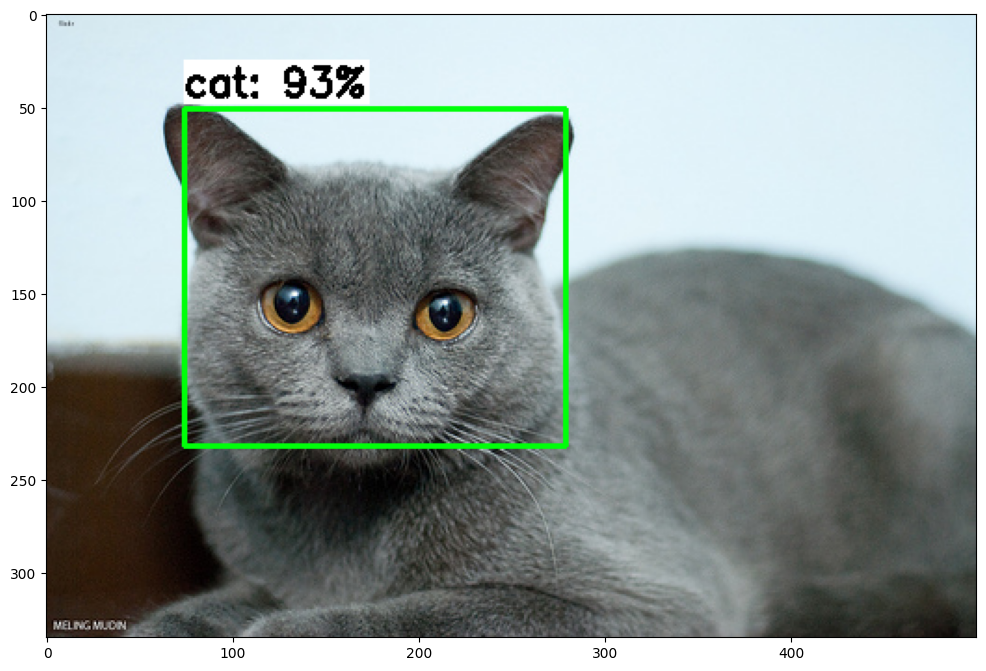

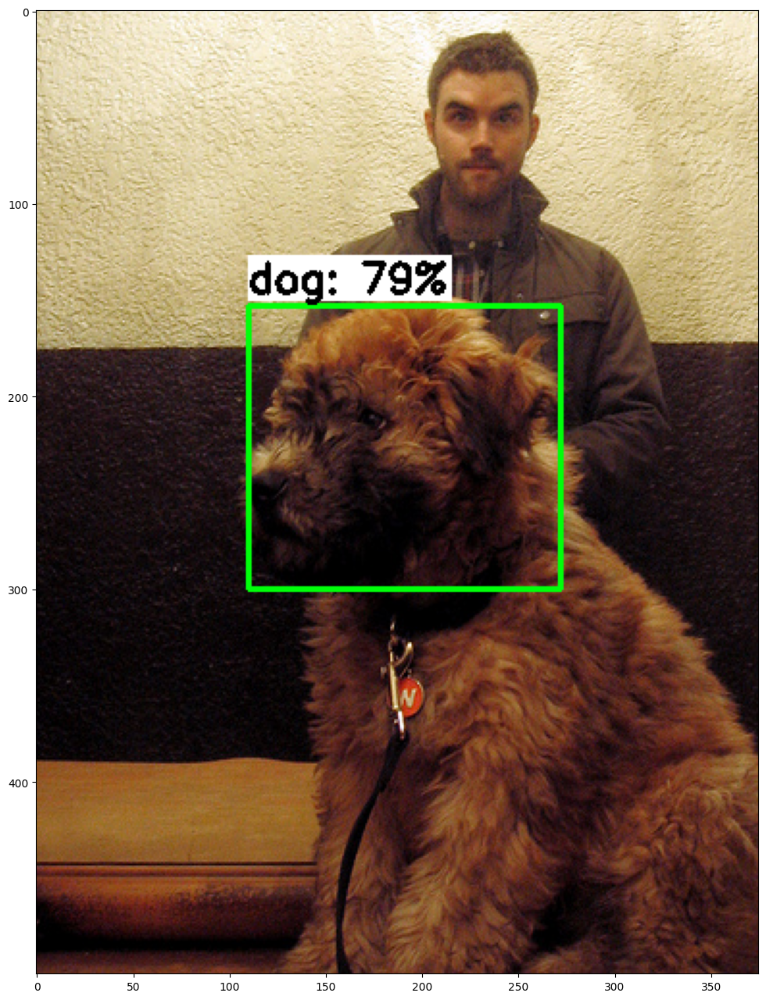

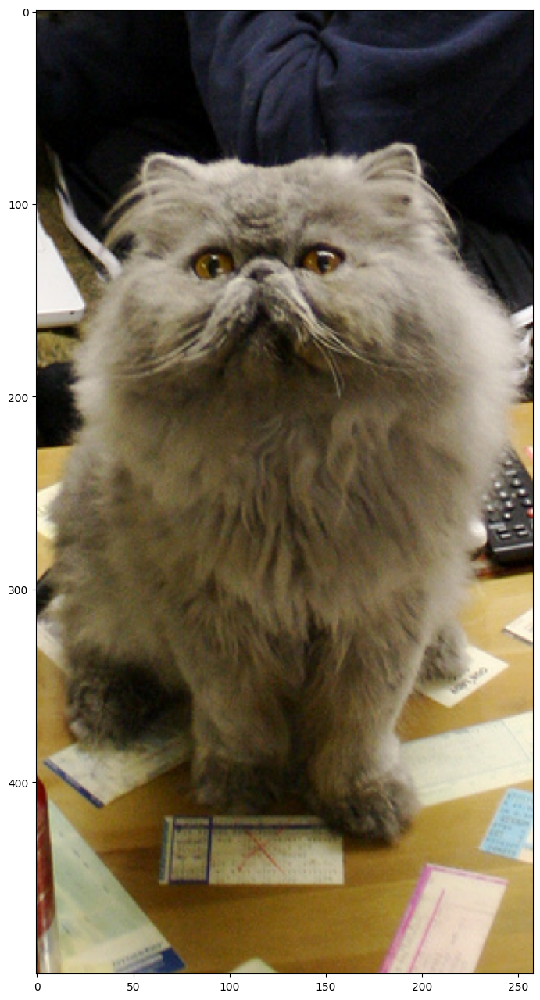

In [ ]:
# Set up variables for running user's model
PATH_TO_IMAGES='/content/gdrive/MyDrive/modelo_entrenar/datos/Imagenes'   # Path to test images folder
PATH_TO_MODEL='/content/gdrive/MyDrive/modelo_entrenar/datos/tflite/model_fp16.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/gdrive/MyDrive/modelo_entrenar/datos/labelmap.txt'   # Path to labelmap.txt file
min_conf_threshold=0.5   # Confidence threshold (try changing this to 0.01 if you don't see any detection results)
images_to_test = 10  # Number of images to run detection on

# Run inferencing function!
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

In [ ]:
!pip freeze > requirements.txt

Evaluacion del modelo


In [ ]:
!pip install --upgrade Pillow


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 25.3 MB/s eta 0:00:00
  Attempting uninstall: Pillow
    Found existing installation: Pillow 8.4.0
    Uninstalling Pillow-8.4.0:
      Successfully uninstalled Pillow-8.4.0


Se realiza la evaluacion del modelo , pero cabe resaltar que al guardar los checkpoints presenta una dificultad

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir}\
    --alsologtostderr

2023-07-26 13:25:05.192191: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-26 13:25:06.501657: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6Status12empty_stringB5cxx11Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/dist-pac

In [ ]:
!pip freeze > requirementswi.txt